<a href="https://colab.research.google.com/github/Nour-25/machine_Learning_simple_project/blob/main/regression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.animation as animation
from matplotlib import rc
import unittest


In [ ]:
%matplotlib inline
sns.set(style='whitegrid',palette='muted',font_scale=1.5)
rcParams['figure.figsize']=14,8
RANDOM_SEED=42
np.random.seed(RANDOM_SEED)
def run_tests():
  unittest.main(argv=[''],verbosity=1, exit=False )
  #argv tab de vecteur


load data

In [ ]:
!wget https://raw.githubusercontent.com/Data-Science-FMI/ml-from-scratch-2019/master/data/house_prices_train.csv


--2020-03-01 13:30:28--  https://raw.githubusercontent.com/Data-Science-FMI/ml-from-scratch-2019/master/data/house_prices_train.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 460676 (450K) [text/plain]
Saving to: ‘house_prices_train.csv’

house_prices_train. 100%[===================>] 449.88K  --.-KB/s    in 0.06s   

2020-03-01 13:30:28 (7.13 MB/s) - ‘house_prices_train.csv’ saved [460676/460676]



In [ ]:
df_train=pd.read_csv('house_prices_train.csv')

data exploration

In [ ]:
df_train['SalePrice'].describe()

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

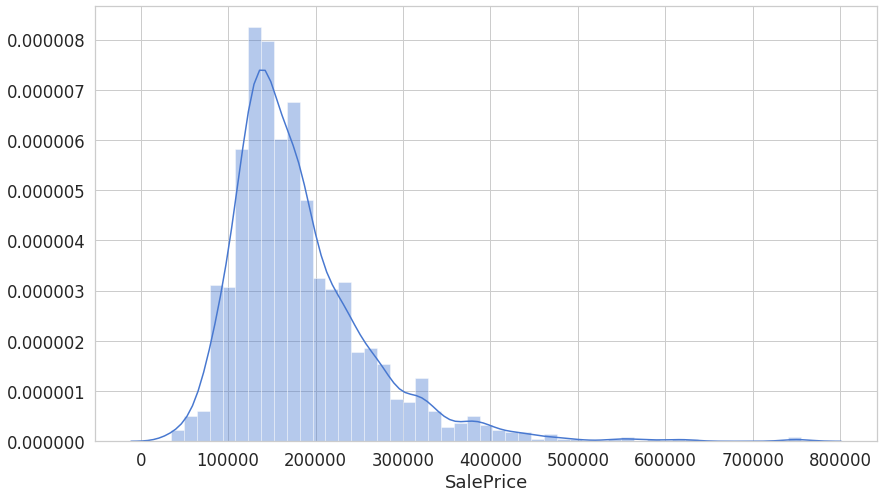

In [ ]:
sns.distplot(df_train['SalePrice'])

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


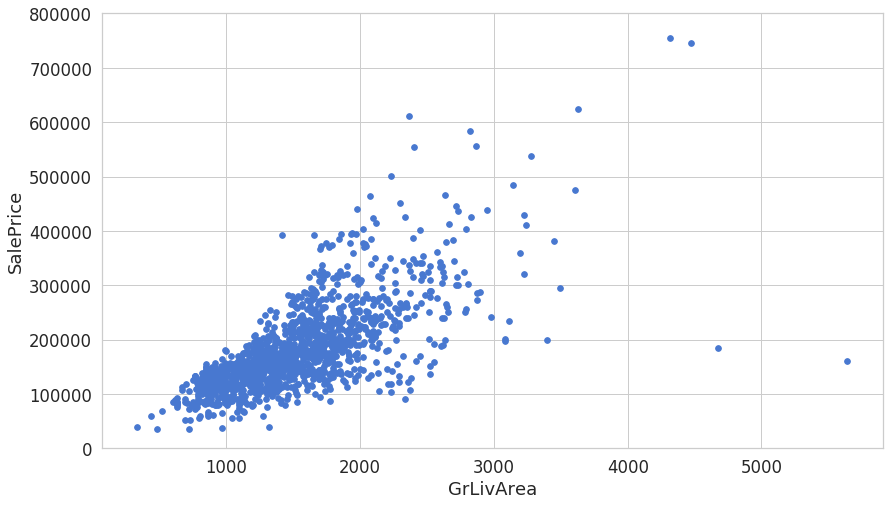

In [ ]:
var='GrLivArea'
data=pd.concat([df_train['SalePrice'],df_train[var]],axis=1)
data.plot.scatter(x=var,y='SalePrice',ylim=(0,800000),s=32);

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


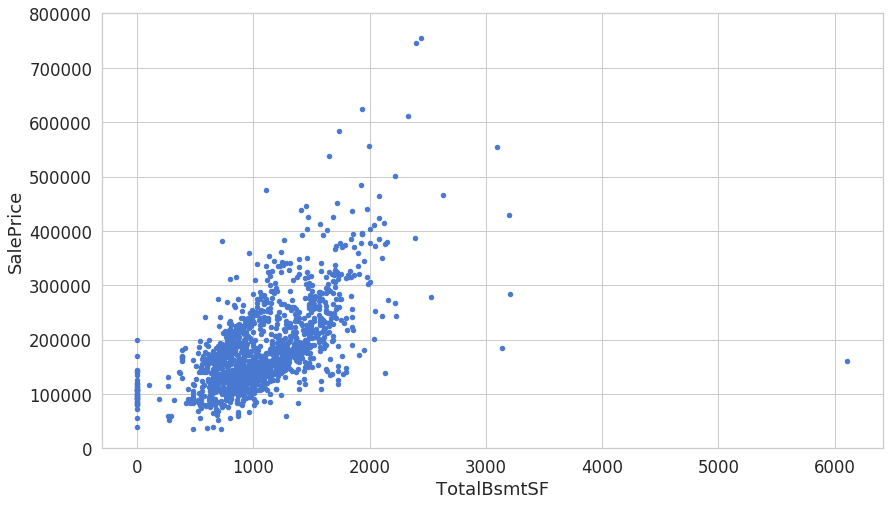

In [ ]:
var='TotalBsmtSF'
data=pd.concat([df_train['SalePrice'],df_train[var]],axis=1)
data.plot.scatter(x=var,y='SalePrice',ylim=(0,800000));

(-0.5, 9.5, 0, 800000)

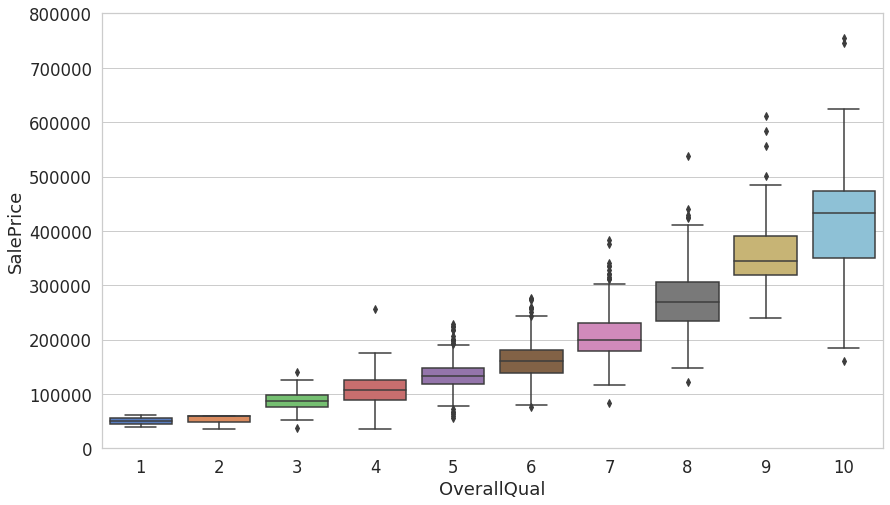

In [ ]:
var='OverallQual'
data=pd.concat([df_train['SalePrice'],df_train[var]],axis=1)
f,ax=plt.subplots(figsize=(14, 8))
fig=sns.boxplot(x=var,y='SalePrice',data=data)
fig.axis(ymin=0,ymax=800000)


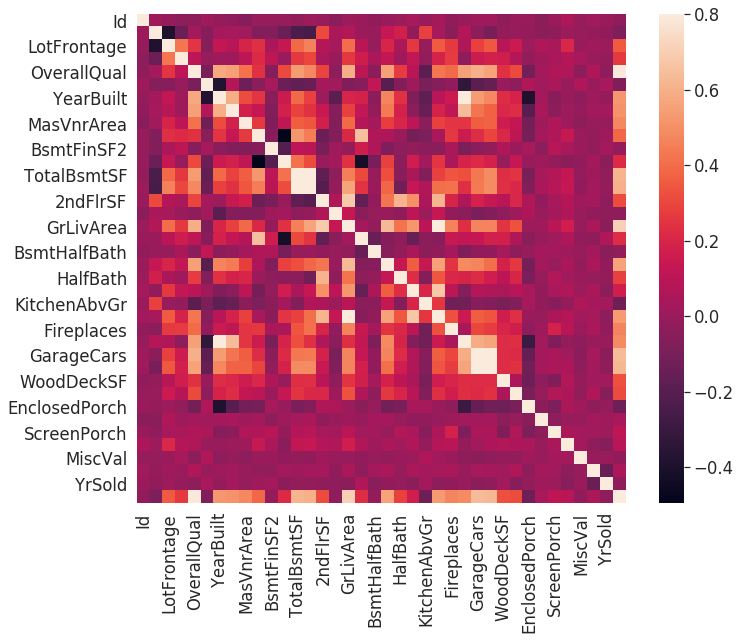

In [ ]:
corrmat=df_train.corr()
f,ax=plt.subplots(figsize=(12, 9))
sns.heatmap(corrmat,vmax=.8,square=True)

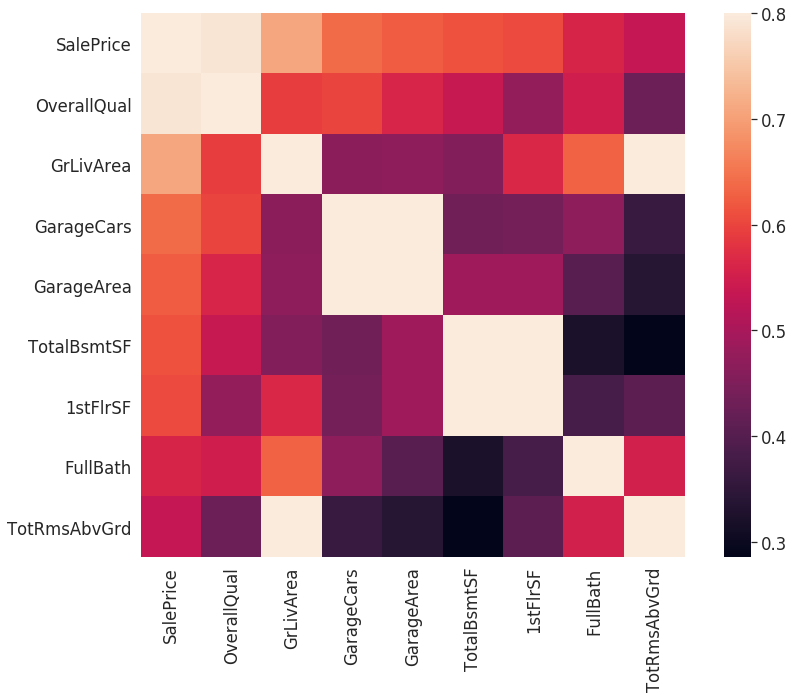

In [ ]:
k=9#nbr de variable for heatmap
cols=corrmat.nlargest(k,'SalePrice')['SalePrice'].index
f,ax=plt.subplots(figsize=(14, 10))
sns.heatmap(df_train[cols].corr(),vmax=.8,square=True)
#akthar 9 yathrou fi saleprices

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:2079: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


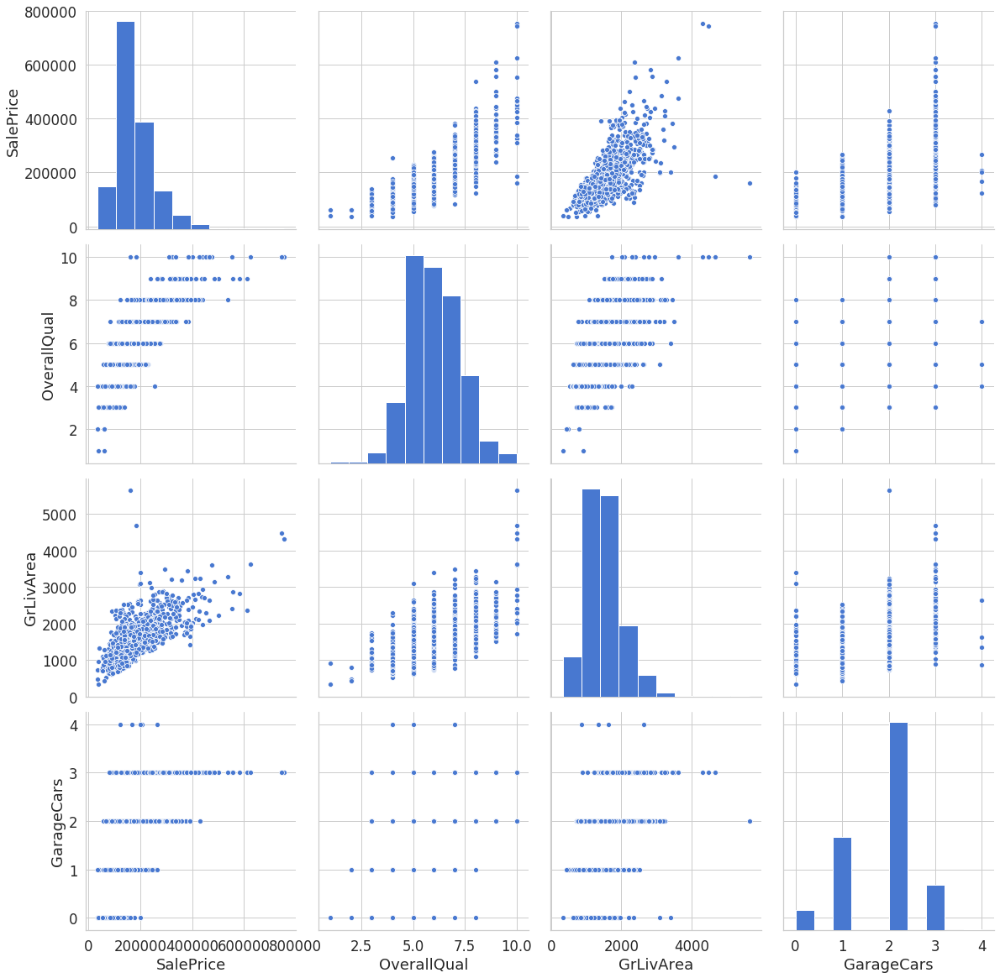

In [ ]:
cols=['SalePrice','OverallQual','GrLivArea','GarageCars']
sns.pairplot(df_train[cols],size=4)

do we have messing data?

In [ ]:
total = df_train.isnull().sum().sort_values(ascending=False)
precent = (df_train.isnull().sum()/df_train.isnull().count()).sort_values(ascending=False)
missing_data=pd.concat([total,precent], axis=1, keys=['total', 'precent'])
missing_data.head(20)

,total,precent
PoolQC,1453,0.995205
MiscFeature,1406,0.963014
Alley,1369,0.937671
Fence,1179,0.807534
FireplaceQu,690,0.472603
LotFrontage,259,0.177397
GarageCond,81,0.055479
GarageType,81,0.055479
GarageYrBlt,81,0.055479
GarageFinish,81,0.055479


In [ ]:
x=df_train['GrLivArea']
y=df_train['SalePrice']

x=(x-x.mean())/x.std()
x=np.c_[np.ones(x.shape[0]),x]

In [ ]:
x.shape

(1460, 2)

In [ ]:
def loss (h, y):
 sq_error = (h - y)**2
 n = len(y)
 return 1.0 / (2*n) *sq_error.sum()

In [ ]:
class TestLoss(unittest.TestCase):

  def test_zero_h_zero_y(self):
    self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([0])), 0)

  def test_one_h_zero_y(self):
    self.assertAlmostEqual(loss(h=np.array([1]), y=np.array([0])), 0.5)
  def test_two_h_zero_y(self):
    self.assertAlmostEqual(loss(h=np.array([2]), y=np.array([0])), 2)
  def test_zero_h_one_y(self):
    self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([1])), 0.5)
  def test_zero_h_two_y(self):
    self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([2])), 2)

In [ ]:
run_tests()

.....
----------------------------------------------------------------------
Ran 5 tests in 0.006s

OK


In [ ]:
class LinearRegression:
  
  def predict(self, X):
    return np.dot(X, self._W)
  
  def _gradient_descent_step(self, X, targets, lr):

    predictions = self.predict(X)
    
    error = predictions - targets
    gradient = np.dot(X.T,  error) / len(X)

    self._W -= lr * gradient
      
  def fit(self, X, y, n_iter=100000, lr=0.01):

    self._W = np.zeros(X.shape[1])

    self._cost_history = []
    self._w_history = [self._W]
    for i in range(n_iter):
      
        prediction = self.predict(X)
        cost = loss(prediction, y)
        
        self._cost_history.append(cost)
        
        self._gradient_descent_step(x, y, lr)
        
        self._w_history.append(self._W.copy())
    return self

In [ ]:
class TestLinearRegression(unittest.TestCase):
  def test_find_coefficients(self):
    clf = LinearRegression()
    clf.fit(x, y, n_iter=2000, lr=0.01)
    np.testing.assert_array_almost_equal(clf._W, np.array([180921.19555322,  56294.90199925]))

In [ ]:
run_tests()

......
----------------------------------------------------------------------
Ran 6 tests in 1.565s

OK


In [ ]:
clf = LinearRegression()
clf.fit(x, y, n_iter=2000, lr=0.01 )

In [ ]:
clf._W

array([180921.19555322,  56294.90199925])

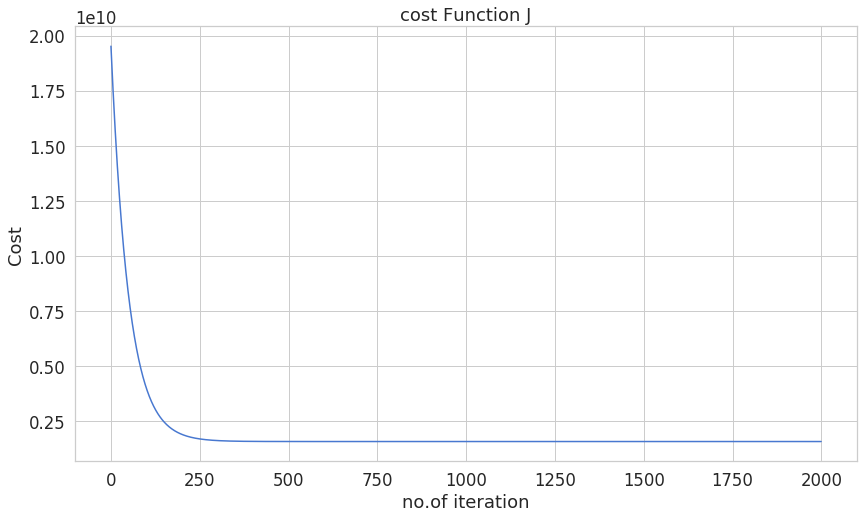

In [ ]:
#cost function ta3ti relation0 bin lexprcted w el prodicted 
plt.title('cost Function J')
plt.xlabel('no.of iteration')
plt.ylabel('Cost')
plt.plot(clf._cost_history)
plt.show()

In [ ]:
clf._cost_history[-1]

1569921604.8332634

In [ ]:
# animation

#set the plot up
fig = plt.figure()
ax=plt.axes()
plt.title('Sale Price vs Living Area')
plt.xlabel('Living Area in square feet (normalised)')
plt.ylabel('Sale Price(£)')
plt.scatter(x[:,1],y)
line, =ax.plot([], [], lw=2, color='red')
annotation=ax.text(-1, 700000, '')
plt.close()

#generate the animation data,
def init():
   line.set_data([], [])
   annotation.set_text('')
   return line, annotation
#animation function .this is called sequentlially
def animate(i):
  x=np.linspace(-5,20,1000)
  y = clf._w_history[i][1]*x + clf._w_history[i][0]
  line.set_data(x, y)
  annotation.set_text('cost = %.2f e10' % (clf._cost_history[i]/10000000000))
  return line, annotation

anim = animation.FuncAnimation(fig, animate, init_func = init, frames=300, interval=10, blit=True)

rc('animation', html='jshtml')

anim

Animation size has reached 21038115 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
x = df_train[['OverallQual','GrLivArea','GarageCars']]
x =(x - x.mean()) / x.std()
x=np.c_[np.ones(x.shape[0]),x]

clf = LinearRegression()
clf.fit(x, y, n_iter=2000, lr=0.01 )



In [ ]:
clf._W

array([180921.19555322,  37478.604254  ,  26631.93830568,  15921.22581327])

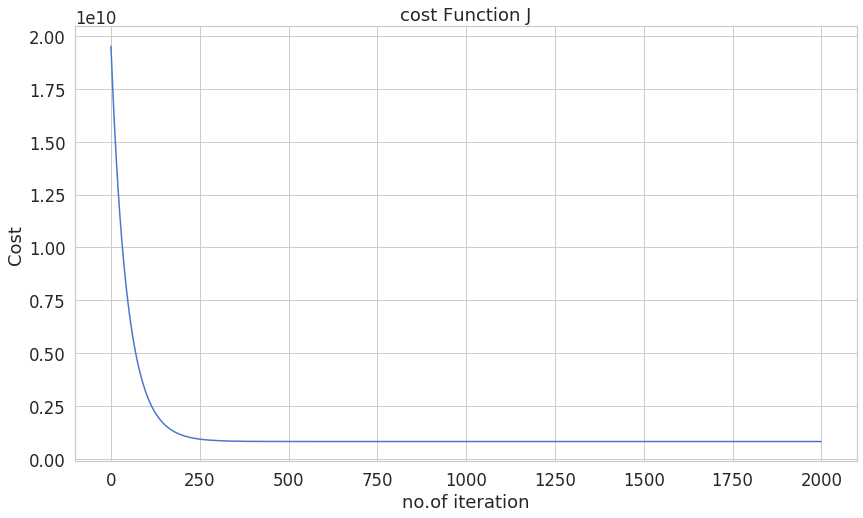

In [ ]:
plt.title('cost Function J')
plt.xlabel('no.of iteration')
plt.ylabel('Cost')
plt.plot(clf._cost_history)
plt.show()